<a href="https://colab.research.google.com/github/tackulus/204383/blob/main/Code07.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **07 1st Filtering**

> **204383 Image Processing** 

---

> **Tocktack | Kasidis Torcharoen (610510531)** \\
**Top | Kittisak Thammawong (610510611)**

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import cv2 as cv
from google.colab.patches import cv2_imshow

In [9]:
#@title
def salt_pepper(image, s_ratio=0.5, sp_ratio=0.30):

    if image.ndim == 2: 
        image = np.expand_dims(image, axis=2)
    row, col, ch = image.shape
    noisy = np.copy(image)

    for c in range(ch):
        for i in range(row):
            for j in range(col):
                rnd = np.random.random()
                if rnd > sp_ratio: pass
                elif rnd < sp_ratio * s_ratio: 
                    noisy[i,j,c] = 255
                else:
                    noisy[i,j,c] = 0
    
    return noisy.astype("uint8")

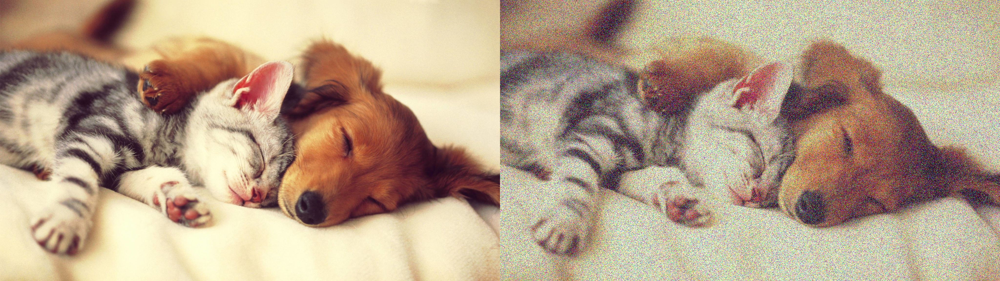

In [96]:
image = cv.imread('0302.jpg')
noisy = salt_pepper(image)
frame = np.concatenate((image, noisy), axis=1)
cv2_imshow(frame)

# Correlation linear filter : Edge detection

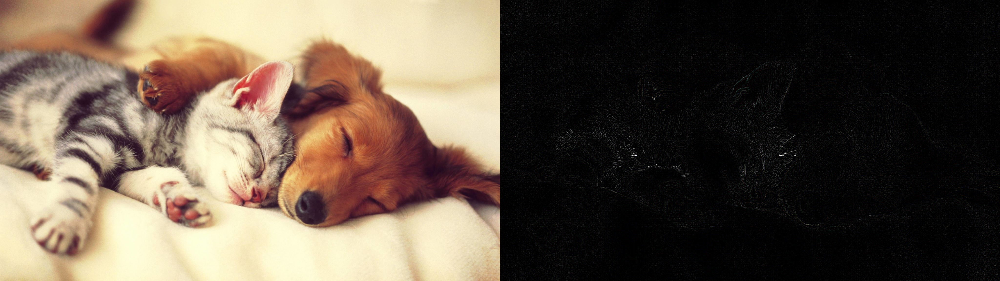

In [93]:
def EdgeDetection(image):
    kernel = np.array([[-1, -1, -1],
                       [-1,  8, -1],
                       [-1, -1, -1]])
    
    return cv.filter2D(image, -1, kernel)

result = EdgeDetection(image)
frame = np.concatenate((image, result), axis=1)
cv2_imshow(frame)

# Correlation linear filter : Sobel edge detection

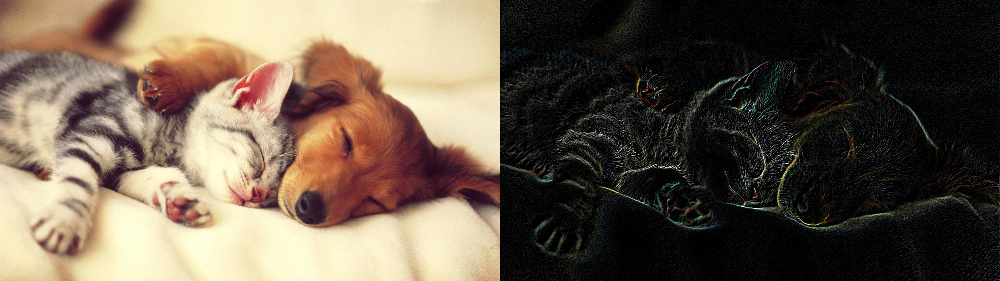

In [126]:
def SobelEdgeDetection(image):
    sobelX = np.array([[-1, 0, 1],
                       [-2, 0, 2],
                       [-1, 0, 1]])

    sobelY = np.array([[-1,-2,-1],
                       [ 0, 0, 0],
                       [ 1, 2, 1]])
    
    result_x = cv.filter2D(image, -1, sobelX)
    result_y = cv.filter2D(image, -1, sobelY)
    
    return result_x + result_y

result = SobelEdgeDetection(image)
frame = np.concatenate((image, result), axis=1)
cv2_imshow(frame)

# Correlation linear filter : Box blur

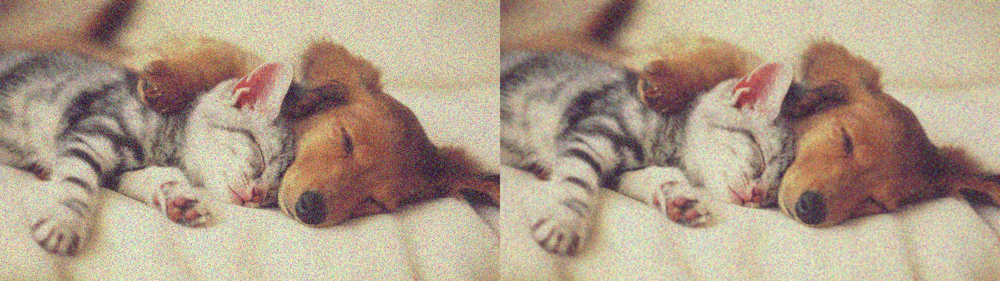

In [95]:
def BoxBlur(image, m=3):
    kernel = (1/np.square(m)) * np.ones((m, m))
    return cv.filter2D(image, -1, kernel)

result = BoxBlur(noisy, 5)
frame = np.concatenate((noisy, result), axis=1)
cv2_imshow(frame)

# Correlation non-linear filter : Median blur

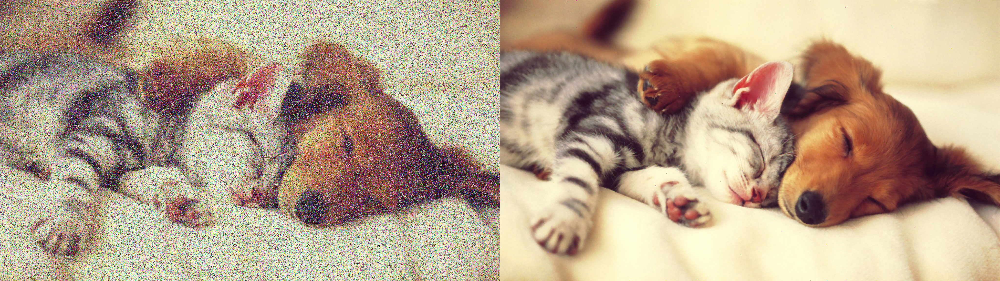

In [87]:
def MedianBlur(image, m=3):
    r_pad = np.zeros((image.shape[0], m-1, 3))
    Padded = np.concatenate((r_pad, image, r_pad), axis=1)
    c_pad = np.zeros((m-1, Padded.shape[1], 3))
    Padded = np.concatenate((c_pad, Padded, c_pad), axis=0)

    result = np.zeros_like(image)
    for i in range(image.shape[0]):
        for j in range(image.shape[1]): 
            for c in range(image.shape[2]):
                kernel = Padded[i:i+m, j:j+m, c]
                result[i,j,c] = np.median(kernel)

    return result

# Too long! So, use build-in function instead
# result = MedianBlur(noisy, 5)
result = cv.medianBlur(noisy, 5)
frame = np.concatenate((noisy, result), axis=1)
cv2_imshow(frame)
